# EDA of Generated Plasma 2D

In [1]:
# Required packages
#!pip install torch torchvision pandas numpy matplotlib scipy plotly tensorboard onnx kaleido

In [3]:
# Visualize tensorboard in the notebook
%load_ext tensorboard
# In order to force reload any changes done to the models package files
%load_ext autoreload
%autoreload 2

In [4]:
## Allow import from our custom lib python files
import sys
import os

module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(os.path.join(module_path, "lib"))

In [23]:
from models.simpleFork import Simple, Fork
from models.danmf import DANMF
from models.convmf import ConvMF
from datasets.gen_plasma_1d import GenPlasma1DDataset

from framework.saveload import load_checkpoint, load_trained_model
from framework.params import * # device, use_cuda, Checkpoint, various saving strs

import os
from timeit import default_timer
import re
from datetime import datetime
import json

# Supress Pandas future deprecation warnings
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import torch
import onnx
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import linalg, sparse 
from torch import nn
from torch.utils.data import DataLoader, random_split
# PyTorch TensorBoard support
from torch.utils.tensorboard import SummaryWriter
from torch import profiler

# Viz
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots
# Settings for plot rendering, makes work with HTML output + jupyer lab + static output
pio.renderers.default = "notebook+plotly_mimetype+png"
# pio.renderers.default = "notebook"

In [24]:
## Params
data_dir = os.path.join("..", "..", "data")
output_dir = os.path.join(data_dir, "output")
tensorboard_dir = os.path.join(output_dir, "tensorboard")

print(f"Using {device} device")

Using cuda device


## Load Data

..\..\data\gen_plasma_n64\mat_0\2669.hdf5 2669
21975


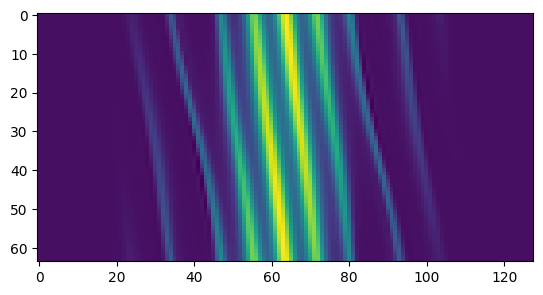

In [96]:
## Params
mat_dir = os.path.join(data_dir, "gen_plasma_n64")
mat_dirs = [os.path.join(mat_dir, f"mat_{i}") for i in range(3)]

# Load and split the data, and prep for being fed into the NN
data = GenPlasma1DDataset(mat_dirs, return_imname=True)

# Divide data into train, validation, test
# Use same code as run_models so that the train_data isn't used
train_data, validation_data, test_data = random_split(data, [0.7, 0.2, 0.1], generator=torch.Generator().manual_seed(42))

dataloader = DataLoader(validation_data + test_data, batch_size=1, shuffle=True)

print(data[2669][1], data[2669][2])
print(len(data))
plt.imshow(data[2669][0])

## Load Models

In [98]:
# ranks = [6, 12]
ranks = [5, 7, 8, 9, 10, 11]
n_ranks = len(ranks)
machine = "PC"
runname = "plasma_mf_2"
output_run_dir = os.path.join(output_dir, f"run_{runname}")
model_ranks = ranks
model_classes = [ConvMF] * n_ranks
# model_classes = [Fork] * n_ranks + [ConvMF] * n_ranks
model_names =  [f"{model_classes[i]().__class__.__name__}" +
                f"{'_r'+str(r) if r != 6 else ''}" + "_img64" +
                f"{'_sdim2-3ebc_fdim2-37e7' if model_classes[i] == Fork else '_cdim2-c00f'}" \
                for i, r in enumerate(model_ranks)]
models = []

for i in range(len(model_classes)):
    cls = model_classes[i]
    model_str_name = model_names[i]
    model = load_trained_model(cls, machine, runname, model_str_name, output_run_dir)
    model.eval()
    models.append(model)

print(model_ranks)

Found model state dict to load. Using: PC_ConvMF_r5_img64_cdim2-c00f_state-dict_2024-02-18_235023.pt
Found model state dict to load. Using: PC_ConvMF_r7_img64_cdim2-c00f_state-dict_2024-02-19_013300.pt
Found model state dict to load. Using: PC_ConvMF_r8_img64_cdim2-c00f_state-dict_2024-02-19_031214.pt
Found model state dict to load. Using: PC_ConvMF_r9_img64_cdim2-c00f_state-dict_2024-02-19_044851.pt
Found model state dict to load. Using: PC_ConvMF_r10_img64_cdim2-c00f_state-dict_2024-02-19_061858.pt
Found model state dict to load. Using: PC_ConvMF_r11_img64_cdim2-c00f_state-dict_2024-02-19_080025.pt
[5, 7, 8, 9, 10, 11]


## Run Models and Comparison SVD

In [99]:
def basic_svd(img):
    start_svd = default_timer()
    U_svd, S, V_svd = linalg.svd(img)
    end_svd = default_timer() - start_svd
    return U_svd, S, V_svd, end_svd

def basic_svd_ranks(img, ranks):
    U, S, V, time = basic_svd(img)
    svds = [U[:, :r] @ linalg.diagsvd(S[:r], r, r) @ V[:r, :] for r in ranks]
    return svds, time

def faster_svd(img, rank):
    start = default_timer()
    U, S, V = sparse.linalg.svds(img, k=rank)
    end = default_timer() - start
    
    svd_USV = U.dot(np.diag(S)).dot(V)

    return svd_USV, end 

In [100]:
def to_dict(Img, Rank, Model, Name, Loss, Time):
    return dict(Img=Img, Rank=Rank, Model=Model, Name=Name, Loss=Loss, Time=Time)

def to_dict_fromlist(x):
    return dict(Img=x[0], Rank=x[1], Model=x[2], Name=x[3], Loss=x[4], Time=x[5])

def mf_loss(img, uv):
    return np.square(np.linalg.norm(img - uv, ord="fro"))

In [102]:
losses = []
n_imgs = len(dataloader)

for i, (mat, img_name, img_idx) in enumerate(dataloader):
    mat = mat.to(device)
    
    UVs = []
    nn_times = []
    # Run and time the NNs
    for model in models:
        start_nn = default_timer()
        U_nn, V_nn = model(mat)
        nn_times.append(default_timer() - start_nn)
        
        U_nn = torch.squeeze(U_nn).cpu().detach().numpy()
        V_nn = torch.squeeze(V_nn).cpu().detach().numpy()
        UV_nn = np.maximum(np.matmul(U_nn, V_nn), 0)
        UVs.append(UV_nn)
        

    # Reshape img for use with scipy SVDs, and for computing NN loss
    mat = torch.squeeze(mat.to("cpu")).numpy()
    # Compute and add losses per NN model
    loss_nn = [mf_loss(mat, uv) for uv in UVs]
    losses.extend(list(map(to_dict, [img_idx]*len(model_ranks), 
                       model_ranks, 
                       map(lambda x: x().__class__.__name__, model_classes), 
                       model_names, 
                       loss_nn, 
                       nn_times 
                      )))

    # Run and time the basic SVD runs once across multiple ranks
    svds, time = basic_svd_ranks(mat, ranks)
    losses_svd = [mf_loss(mat, uv) for uv in svds]
    losses.extend(list(map(to_dict, [img_idx]*n_ranks, 
                           ranks, 
                           ["Basic SVD"]*n_ranks, 
                           ["Basic SVD"]*n_ranks, 
                           losses_svd, 
                           [time]*n_ranks 
                          )))

    # Run and time better SVD
    svds_f, times_svd_f = zip(*[(faster_svd(mat, r)) for r in ranks])
    losses_svd_f = [mf_loss(mat, uv) for uv in svds_f]
    losses.extend(list(map(to_dict, [img_idx]*n_ranks, 
                           ranks, 
                           ["Faster SVD"]*n_ranks, 
                           ["Faster SVD"]*n_ranks, 
                           losses_svd_f, 
                           times_svd_f 
                          )))
    
    if i % 200 == 199:
        print(f"img {i}/{n_imgs}")

img 199/6592
img 399/6592
img 599/6592
img 799/6592
img 999/6592
img 1199/6592
img 1399/6592
img 1599/6592
img 1799/6592
img 1999/6592
img 2199/6592
img 2399/6592
img 2599/6592
img 2799/6592
img 2999/6592
img 3199/6592
img 3399/6592
img 3599/6592
img 3799/6592
img 3999/6592
img 4199/6592
img 4399/6592
img 4599/6592
img 4799/6592
img 4999/6592
img 5199/6592
img 5399/6592
img 5599/6592
img 5799/6592
img 5999/6592
img 6199/6592
img 6399/6592


### Save losses

In [105]:
df_losses = pd.DataFrame(losses)
df_losses = df_losses.astype({"Model": "category", "Name": "category" })
df_losses["Img"] = df_losses["Img"].map(lambda x: x[0].item())

df_losses.to_csv(os.path.join(output_run_dir, "df_losses.csv"), index=False)

print(df_losses.dtypes)
df_losses

Img         int64
Rank        int64
Model    category
Name     category
Loss      float32
Time      float64
dtype: object


,Img,Rank,Model,Name,Loss,Time
0,1101,5,ConvMF,ConvMF_r5_img64_cdim2-c00f,3.243430e-01,0.000999
1,1101,7,ConvMF,ConvMF_r7_img64_cdim2-c00f,9.247983e-02,0.000615
2,1101,8,ConvMF,ConvMF_r8_img64_cdim2-c00f,8.325154e-02,0.000495
3,1101,9,ConvMF,ConvMF_r9_img64_cdim2-c00f,9.615655e-02,0.000594
4,1101,10,ConvMF,ConvMF_r10_img64_cdim2-c00f,6.944776e-02,0.000451
...,...,...,...,...,...,...
118651,20235,7,Faster SVD,Faster SVD,7.489843e-04,0.000334
118652,20235,8,Faster SVD,Faster SVD,3.552991e-04,0.000306
118653,20235,9,Faster SVD,Faster SVD,4.331618e-05,0.000309
118654,20235,10,Faster SVD,Faster SVD,1.080879e-05,0.000321


# Visualization

### Load losses

In [108]:
df_r_612 = pd.read_csv(os.path.join(output_dir, "run_plasma_mf_test_1", "df_losses.csv"), dtype={"Model": "category", "Name": "category" })
df_r_rest = pd.read_csv(os.path.join(output_run_dir, "df_losses.csv"), dtype={"Model": "category", "Name": "category" })

df_losses = pd.concat([df_r_612, df_r_rest], ignore_index=True)
df_losses

,Img,Rank,Model,Name,Loss,Time
0,8911,6,Fork,Fork_img64_sdim2-3ebc_fdim2-37e7,1.682632e-01,0.000895
1,8911,12,Fork,Fork_r12_img64_sdim2-3ebc_fdim2-37e7,2.890562e-02,0.000541
2,8911,6,ConvMF,ConvMF_img64_cdim2-c00f,1.498601e-01,0.000640
3,8911,12,ConvMF,ConvMF_r12_img64_cdim2-c00f,1.615086e-02,0.000482
4,8911,6,Basic SVD,Basic SVD,6.171950e-01,0.006585
...,...,...,...,...,...,...
171387,20235,7,Faster SVD,Faster SVD,7.489843e-04,0.000334
171388,20235,8,Faster SVD,Faster SVD,3.552991e-04,0.000306
171389,20235,9,Faster SVD,Faster SVD,4.331618e-05,0.000309
171390,20235,10,Faster SVD,Faster SVD,1.080879e-05,0.000321


## Plots

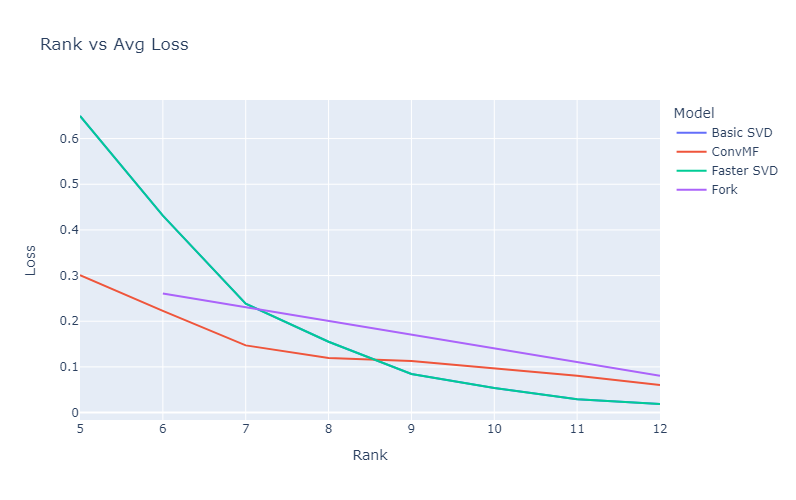

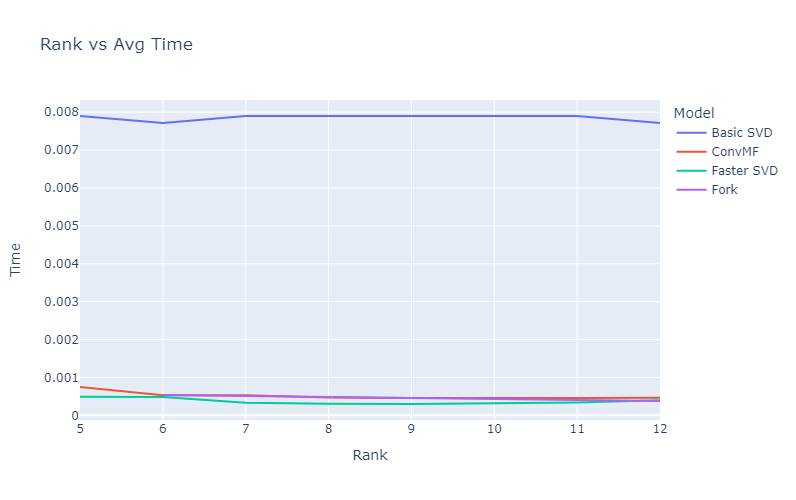

In [109]:
losses_avg = pd.DataFrame(df_losses.groupby(["Rank", "Model"], observed=True)["Loss"].mean()).reset_index()
fig = px.line(losses_avg, x="Rank", y="Loss", color="Model", title="Rank vs Avg Loss")

fig.update_yaxes(showspikes=True, spikemode='toaxis', spikesnap='cursor')
fig.update_xaxes(showspikes=True, spikemode='toaxis', spikesnap='cursor')
fig.update_layout(height=500)
fig.show()

times_avg = pd.DataFrame(df_losses.groupby(["Rank", "Model"], observed=True)["Time"].mean()).reset_index()
fig = px.line(times_avg, x="Rank", y="Time", color="Model", title="Rank vs Avg Time")
fig.update_layout(height=500)
fig.show()

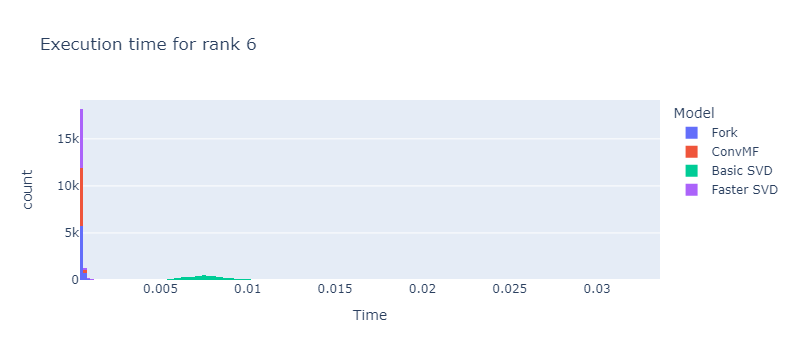

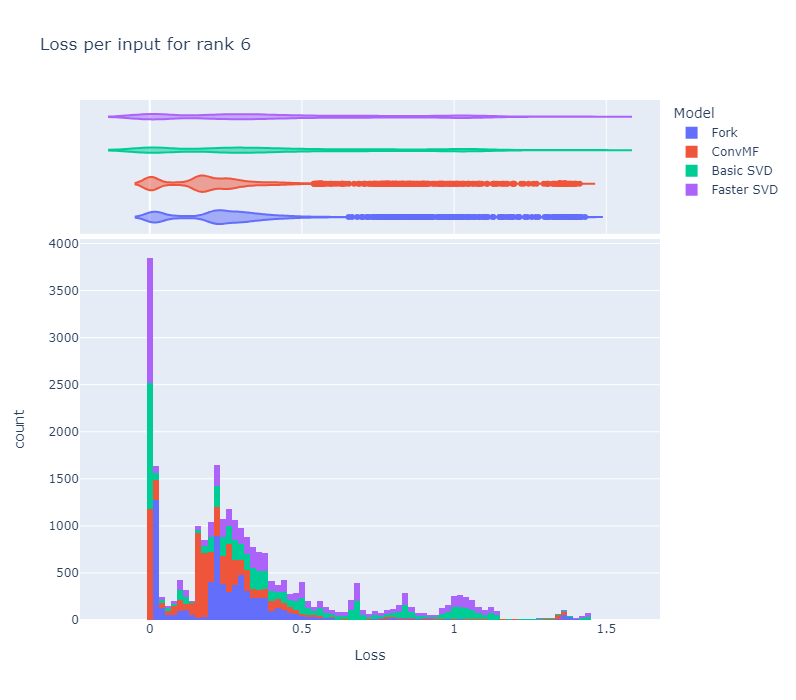

In [112]:
df_r6 = df_losses[df_losses["Rank"] == 6]

fig = px.histogram(df_r6, x="Time", color="Model", title="Execution time for rank 6")
fig.show()

fig = px.histogram(df_r6, x="Loss", color="Model", title="Loss per input for rank 6", marginal="violin")
fig.update_layout(height=700)
fig.show()

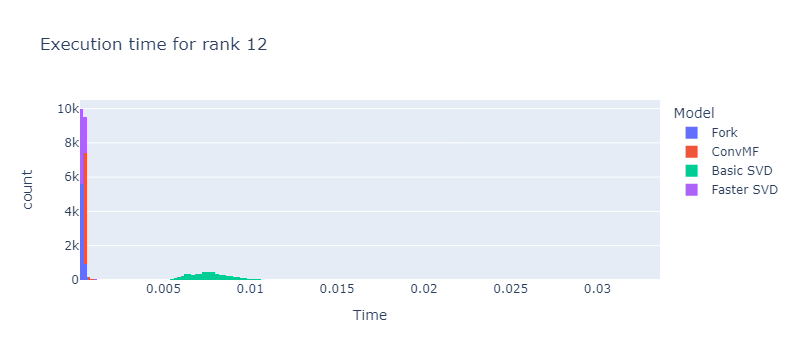

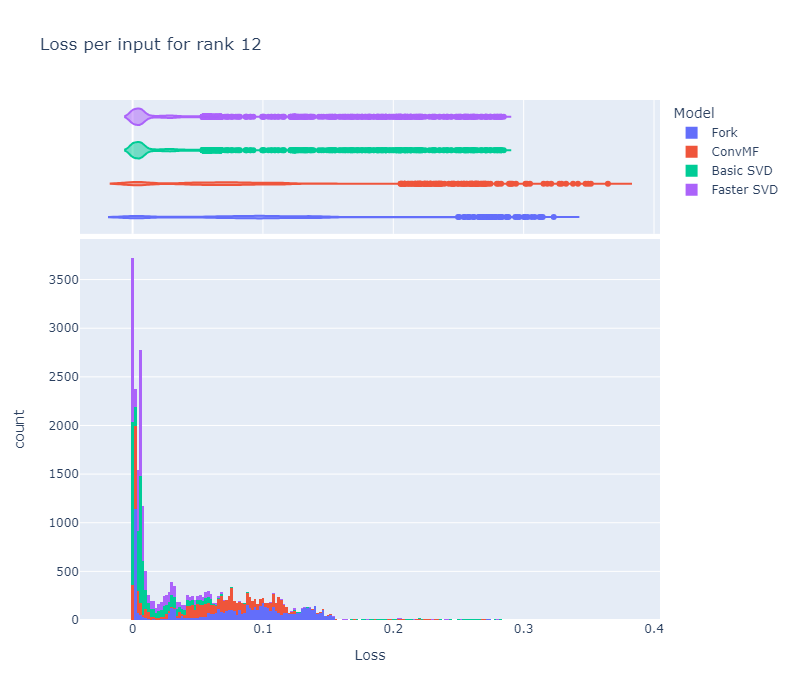

In [113]:
df_r12 = df_losses[df_losses["Rank"] == 12]

fig = px.histogram(df_r12, x="Time", color="Model", title="Execution time for rank 12")
fig.show()

fig = px.histogram(df_r12, x="Loss", color="Model", title="Loss per input for rank 12", marginal="violin")
fig.update_layout(height=700)
fig.show()

In [195]:
df_g.apply(lambda x: x[x["Loss"].isin(quantiles.loc[x.name].values)]).reset_index(drop=True)

,Img,Rank,Model,Name,Loss,Time
0,16302,5,Basic SVD,Basic SVD,1.577509e-12,0.005412
1,373,5,Basic SVD,Basic SVD,2.424265e-01,0.007584
2,1093,5,Basic SVD,Basic SVD,1.033222e+00,0.010475
3,21974,5,Basic SVD,Basic SVD,1.895342e+00,0.006295
4,17233,5,ConvMF,ConvMF_r5_img64_cdim2-c00f,1.168815e-03,0.000666
...,...,...,...,...,...,...
99,21974,12,Faster SVD,Faster SVD,2.847244e-01,0.000388
100,17978,12,Fork,Fork_r12_img64_sdim2-3ebc_fdim2-37e7,1.572743e-03,0.000355
101,614,12,Fork,Fork_r12_img64_sdim2-3ebc_fdim2-37e7,3.237703e-02,0.000373
102,14145,12,Fork,Fork_r12_img64_sdim2-3ebc_fdim2-37e7,1.182221e-01,0.000385


In [228]:
df_g = df_losses[df_losses["Model"].isin(("ConvMF", "Faster SVD"))].sort_values("Loss").groupby(["Rank", "Model"])

# Get quantiles by which to filter
quantiles = df_g["Loss"].quantile([0, 0.25, 0.75, 1], interpolation="lower")

# Filter rows based on being in the quantiles within each group
df_quantiles = df_g.apply(lambda x: x[x["Loss"].isin(quantiles.loc[x.name].values)]).reset_index(drop=True)

# Find average of image between the 0-25% quantile, and 75%-100% quantile
imgs = []
curr_img = None
curr_loss = 0
for i, row in df_quantiles.iterrows():
    if i % 2 == 1:
        imgs.append(dict(Img=((curr_img + data[row["Img"]][0]) / 2), 
                         loss=(row["Loss"] + curr_loss) / 2) | {k:row[k] for k in ["Rank", "Model", "Name"]})
    else:
        curr_img = data[row["Img"]][0]
        curr_loss = row["Loss"]
imgs[:5]

[{'Img': tensor([[ 4.2913e-10,  6.3378e-09,  3.0872e-08,  ...,  2.0249e-08,
            1.5530e-08, -1.1603e-09],
          [ 2.0769e-09,  3.2306e-09,  3.9682e-08,  ...,  2.0409e-08,
            1.9234e-08, -1.1077e-09],
          [ 4.0681e-09,  9.8249e-10,  4.6556e-08,  ...,  2.3291e-08,
            2.0607e-08, -8.1132e-10],
          ...,
          [-1.0636e-09,  1.9519e-08,  2.0869e-08,  ...,  3.9822e-08,
            3.2610e-09,  2.0017e-09],
          [-1.1376e-09,  1.5752e-08,  2.0722e-08,  ...,  3.1294e-08,
            6.6319e-09,  4.2690e-10],
          [-6.7720e-10,  1.0775e-08,  2.3954e-08,  ...,  2.4036e-08,
            1.0900e-08, -6.5976e-10]]),
  'loss': 0.0849365077,
  'Rank': 5,
  'Model': 'ConvMF',
  'Name': 'ConvMF_r5_img64_cdim2-c00f'},
 {'Img': tensor([[ 2.5586e-09,  1.8060e-08,  2.5202e-08,  ...,  1.3788e-08,
            1.3955e-08,  8.0770e-09],
          [ 1.9541e-10,  1.3938e-08,  3.0527e-08,  ...,  1.2914e-08,
            8.3494e-09,  8.3647e-09],
          [-1.

In [241]:
imgs[:4]

[{'Img': tensor([[ 4.2913e-10,  6.3378e-09,  3.0872e-08,  ...,  2.0249e-08,
            1.5530e-08, -1.1603e-09],
          [ 2.0769e-09,  3.2306e-09,  3.9682e-08,  ...,  2.0409e-08,
            1.9234e-08, -1.1077e-09],
          [ 4.0681e-09,  9.8249e-10,  4.6556e-08,  ...,  2.3291e-08,
            2.0607e-08, -8.1132e-10],
          ...,
          [-1.0636e-09,  1.9519e-08,  2.0869e-08,  ...,  3.9822e-08,
            3.2610e-09,  2.0017e-09],
          [-1.1376e-09,  1.5752e-08,  2.0722e-08,  ...,  3.1294e-08,
            6.6319e-09,  4.2690e-10],
          [-6.7720e-10,  1.0775e-08,  2.3954e-08,  ...,  2.4036e-08,
            1.0900e-08, -6.5976e-10]]),
  'loss': 0.0849365077,
  'Rank': 5,
  'Model': 'ConvMF',
  'Name': 'ConvMF_r5_img64_cdim2-c00f'},
 {'Img': tensor([[ 2.5586e-09,  1.8060e-08,  2.5202e-08,  ...,  1.3788e-08,
            1.3955e-08,  8.0770e-09],
          [ 1.9541e-10,  1.3938e-08,  3.0527e-08,  ...,  1.2914e-08,
            8.3494e-09,  8.3647e-09],
          [-1.

## Matrix f visualization

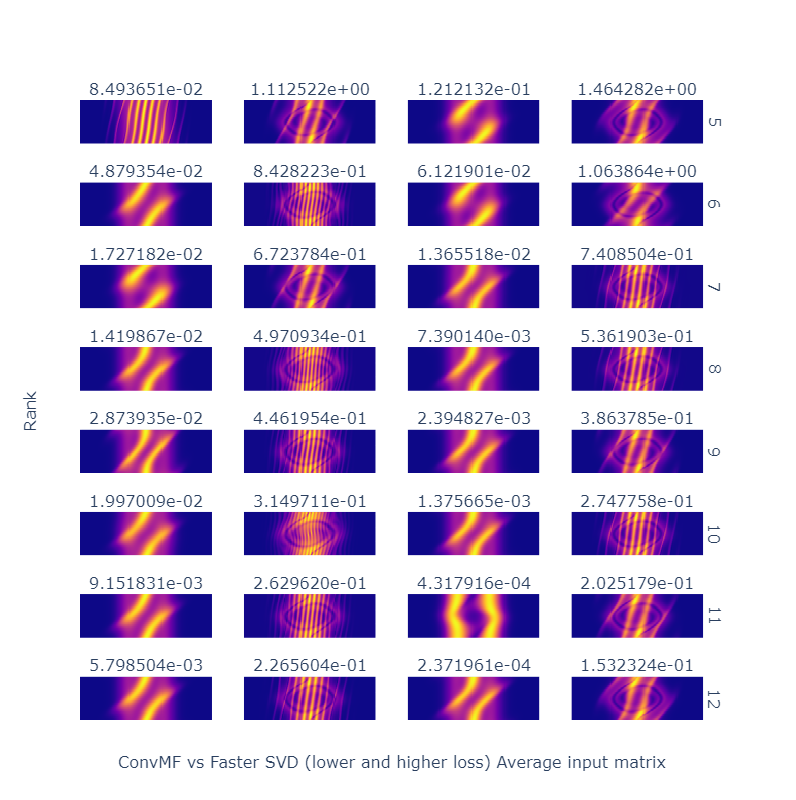

In [268]:
fig = make_subplots(rows=8, 
                    cols=4, 
                    subplot_titles=['{:e}'.format(i['loss']) for i in imgs], 
                    row_titles=[i["Rank"] for i in imgs[::4]],
                    # column_titles=[i["Model"]+ "\n" for i in imgs[:4]],
                    # vertical_spacing=0.25/8,
                    x_title="ConvMF vs Faster SVD (lower and higher loss) Average input matrix",
                    y_title="Rank",
                    shared_xaxes="all", 
                    shared_yaxes="all")
for i, img_data in enumerate(imgs):
    fig.add_trace(go.Heatmap(z=img_data["Img"], showscale=False), 
                  col=(i % 4) + 1, row= (i // 4) + 1)

fig.update_layout(height=800,
                  # margin=dict(t=200),
                  # title_automargin=True
                  # template= '.3f'
                 )
fig.update_xaxes(showticklabels=False).update_yaxes(showticklabels=False)
fig.show()

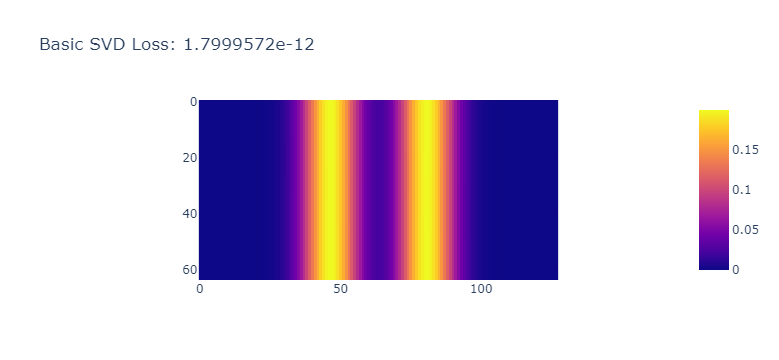

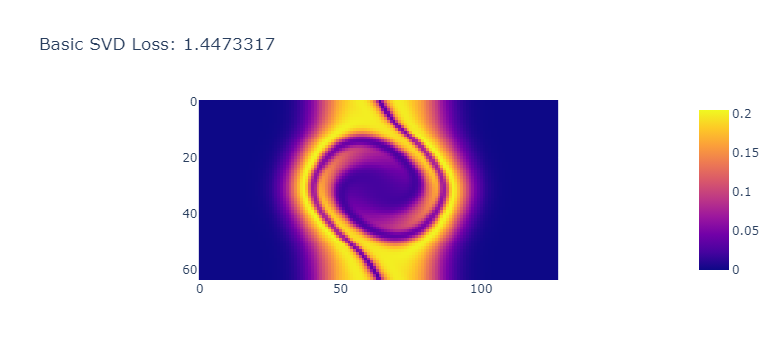

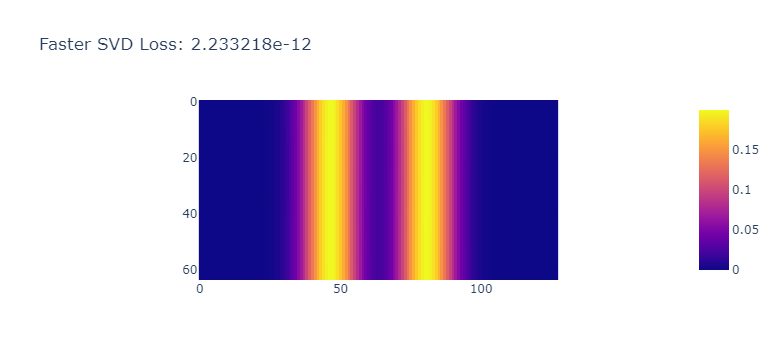

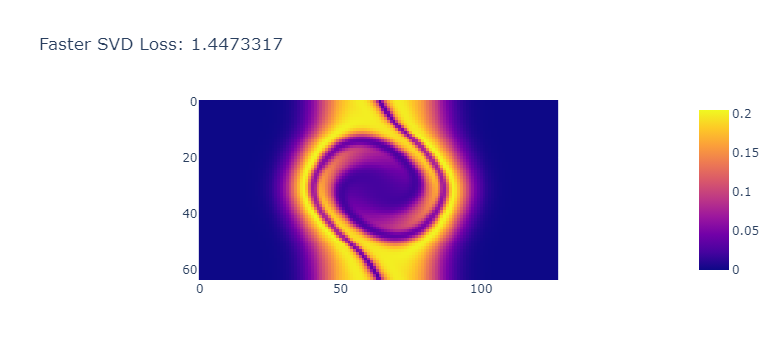

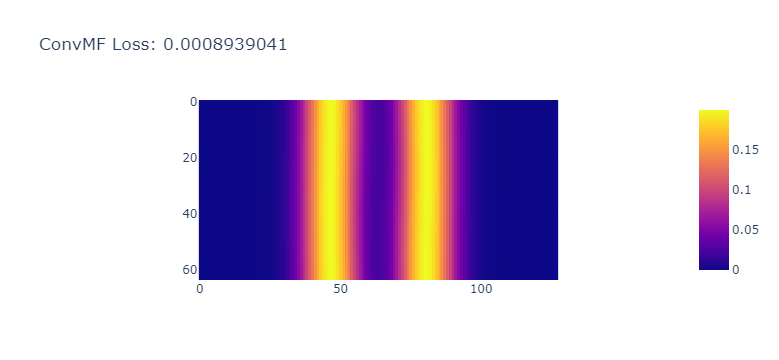

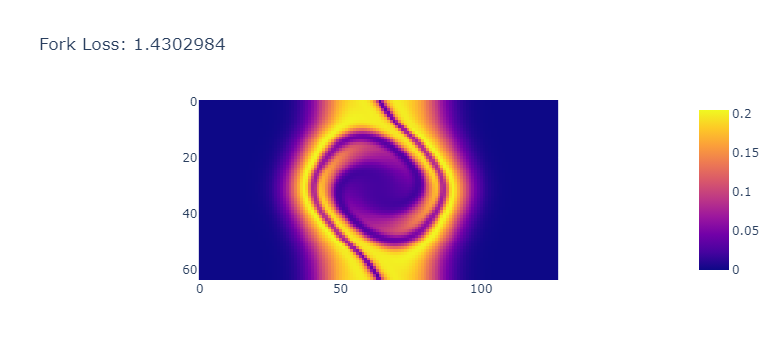

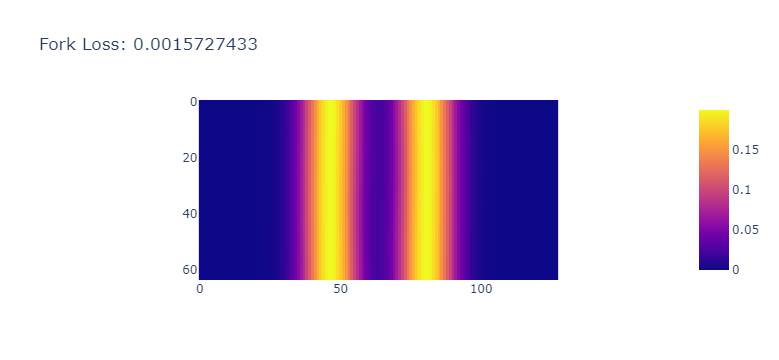

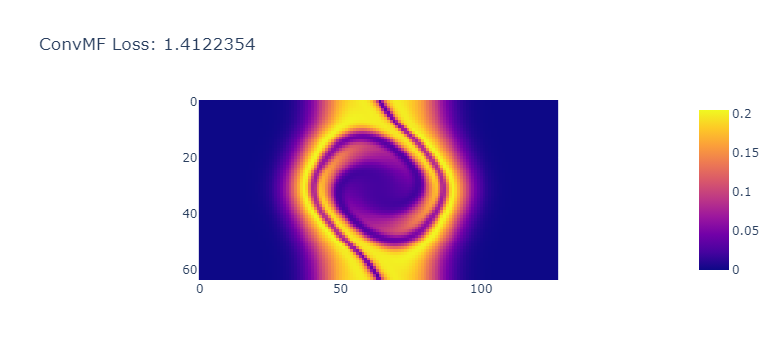

In [94]:
best_losses = df_losses.sort_values("Loss").groupby("Model").nth(0)
worst_losses = df_losses.sort_values("Loss", ascending=False).groupby("Model").nth(0)

for i in range(4):
    row = best_losses.iloc[i]
    px.imshow(data[row["Img"]][0], title=f"{row['Model']} Loss: {row['Loss']}").show()

    row = worst_losses.iloc[i]
    px.imshow(data[row["Img"]][0], title=f"{row['Model']} Loss: {row['Loss']}").show()


16302 21852


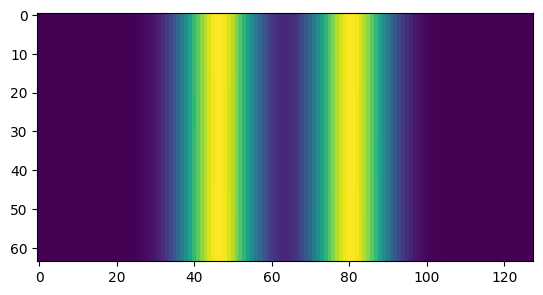

In [77]:
best_idx = df_losses.sort_values("Loss").iloc[0,0]
plt.imshow(data[best_idx][0])

worst_idx = df_losses.sort_values("Loss", ascending=False).iloc[0,0]
print(best_idx, worst_idx)

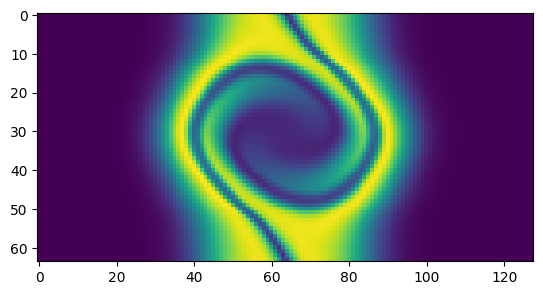

In [76]:
plt.imshow(data[worst_idx][0])

### NN model hyperparameters
  
```json
{
"Fork_sdim2-3ebc_fdim2-37e7": {
    "stem_layer_dims": [500, 200],
    "fork_layer_dims": [ 200, 300 ],
    "rank": 6,
    "img_size": [ 54, 96 ],
    "desc": "Linear layers that fork into two separate channels for U, V"
  },
"ConvMF_cdim2-c00f": {
    "conv_dims": [ [ 5, 1, 3, 1 ], [ 3, 1, 0, 1 ] ],
    "stem_layer_dims": [ 500, 200 ],
    "fork_layer_dims": [ 200, 300 ],
    "rank": 6,
    "img_size": [ 54, 96 ],
    "desc": "Conv laye  into Fork````````` model"
  }
}


conv_dims = `(kernel_sisze, stride, padding, dilation)`

## TODO

* How to use `scipy.linalg.qr` for warm start SVD with NN?
    * Set v0
    * Use `qr` if needs to be orthogonal (try both to see if better)
* ~Move timings for losses before matmul~
* To test really how fast, or strain the speed: Test convergence rate of faster SVD, by using "worse" matrices (less of a gap between spectral values, singular values)
    * "construct" the singular values ourselves, singular vectors could be random (gaussian) aand then make orgthogonal

## Tensorboard

In [ ]:
%tensorboard --logdir "../data/output/tensorboard"